# Compte rendu du TP 3, réalisé par Haithem Daghmoura

# 1-Détection de contours

## 1.1 Filtre de gradient local par masque

### Imports

In [12]:
import tempfile
import IPython
def viewimage(im, normalize=True,titre='',displayfilename=False):
    imin=im.copy().astype(np.float32)
    if normalize:
        imin-=imin.min()
        if imin.max()>0:
            imin/=imin.max()
    else:
        imin=imin.clip(0,255)/255 
    imin=(imin*255).astype(np.uint8)
    filename=tempfile.mktemp(titre+'.png')
    if displayfilename:
        print (filename)
    plt.imsave(filename, imin, cmap='gray')
    IPython.display.display(IPython.display.Image(filename))    
import math
import numpy as np
import matplotlib.pyplot as plt
import skimage as sk
from skimage import data, filters,io
import skimage.morphology as morpho  
import skimage.feature as skf
from scipy import ndimage
from scipy import signal
import mrlab as mr
from sklearn.metrics import pairwise_distances_argmin
from sklearn.datasets import load_sample_image
from sklearn.utils import shuffle
from time import time
from sklearn.cluster import KMeans
from sklearn.datasets import load_sample_image
from sklearn.utils import shuffle
from skimage.filters import threshold_otsu
import platform
import os
import cv2
from scipy import ndimage as ndi
import warnings

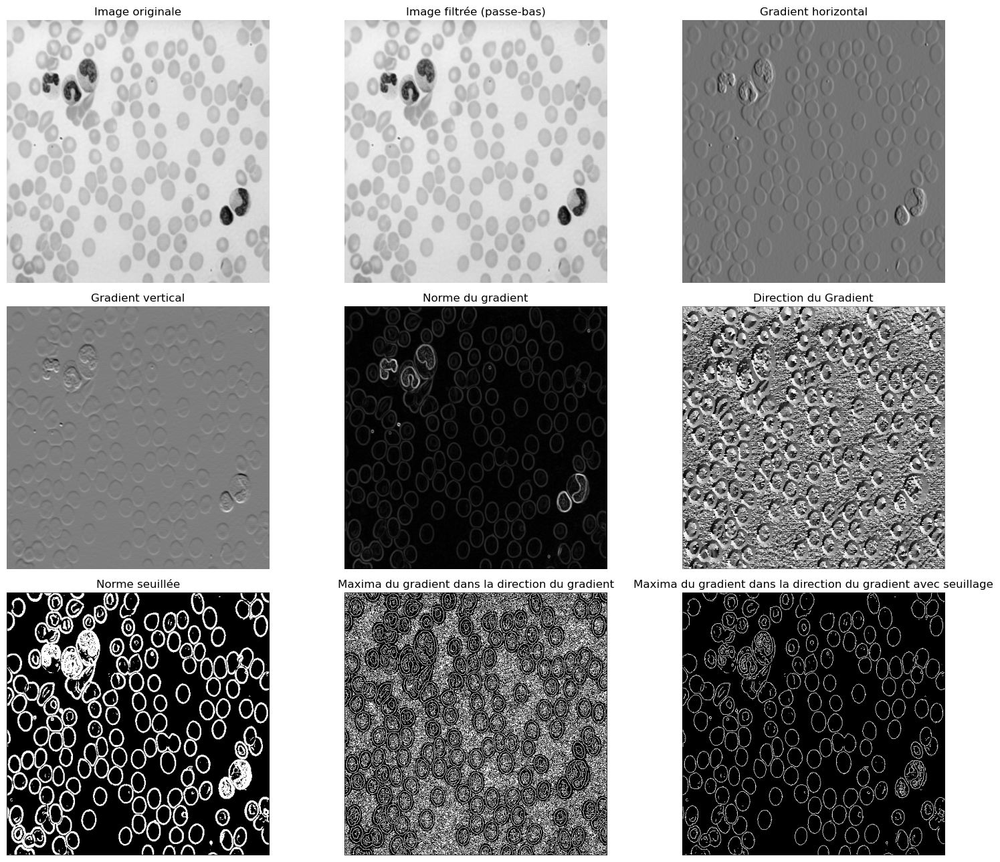

In [10]:
plt.close('all')

ima=io.imread('cell.tif')
sigma=0
seuilnorme=0.1

fig, axes = plt.subplots(3, 3,figsize=(16, 13))

gfima=filters.gaussian(ima,sigma)

axes[0,0].imshow(ima, cmap='gray')
axes[0,0].set_title('Image originale')

axes[0,1].set_title('Image filtrée (passe-bas)')
axes[0,1].imshow(gfima, cmap='gray')

gradx=mr.sobelGradX(gfima)
grady=mr.sobelGradY(gfima)  
      
axes[0,2].set_title('Gradient horizontal')
axes[0,2].imshow(gradx, cmap='gray')

axes[1,0].set_title('Gradient vertical')
axes[1,0].imshow(grady, cmap='gray')

norme=np.sqrt(gradx*gradx+grady*grady)

    
axes[1,1].set_title('Norme du gradient')
axes[1,1].imshow(norme, cmap='gray')

direction=np.arctan2(grady,gradx)
    
axes[1,2].set_title('Direction du Gradient')
axes[1,2].imshow(direction, cmap='gray')


contoursnorme =(norme>seuilnorme) 


axes[2,0].set_title('Norme seuillée')
axes[2,0].imshow(255*contoursnorme,cmap='gray')


contours=np.uint8(mr.maximaDirectionGradient(gradx,grady))

axes[2,1].set_title('Maxima du gradient dans la direction du gradient')
axes[2,1].imshow(255*contours,cmap='gray')


valcontours=(norme>seuilnorme)*contours
      
for i in range (3):
    for j in range(3):
        axes[i,j].axis('off')
#plt.figure()
axes[2,2].set_title('Maxima du gradient dans la direction du gradient avec seuillage')
axes[2,2].imshow(255*valcontours,cmap='gray')
plt.tight_layout()
plt.show()



Le filtre de Sobel est un filtre utilisé dans le traitement d'images pour détecter les contours ou les bords d'objets. Il est principalement utilisé pour calculer une approximation du gradient de l'image à un point donné. Contrairement au filtre de différence simple qui calcule une dérivée en utilisant simplement la différence entre deux pixels voisins, le filtre de Sobel présente plusieurs avantages tels que la reduction du bruit en faisant les moyennes suivant la direction horizental et vertical

Il est géneralement n'est pas nécessaire d'appliquer le filtre passe bas puisque le filtre de sobel integre une structre de moyennage. Cependant cela peut etre tres benefique dans certain cas. En effet, le filtre de sobel  frequence et donc peut detecter dans des region des contour qui sont en realité du au bruit. Donc, dans ce cas, l'application du filtre passe bas va améliorer la detection de coutnour.




En comparent les images obtenu de la norme de gradient avant et après seuillage, on remarque que l'image de norme de gradient brute presente plusieurs niveau de gris ce qui ne permet pas de distinguer la difference entre les contours reels est celle de la vaiance de l'image normale. En ce qui concerne l'image seuillété, on remarque qu'on a une bonne distinction des contours relles. En effet, en utilisant un seuil de la norme on dispose des partie present dans l'image de la norme qui sont faible et qui ne representent pas réellement des contour. Donc le seuillage permet d'eleminer les faux contour detécté qui sont du au bruit 

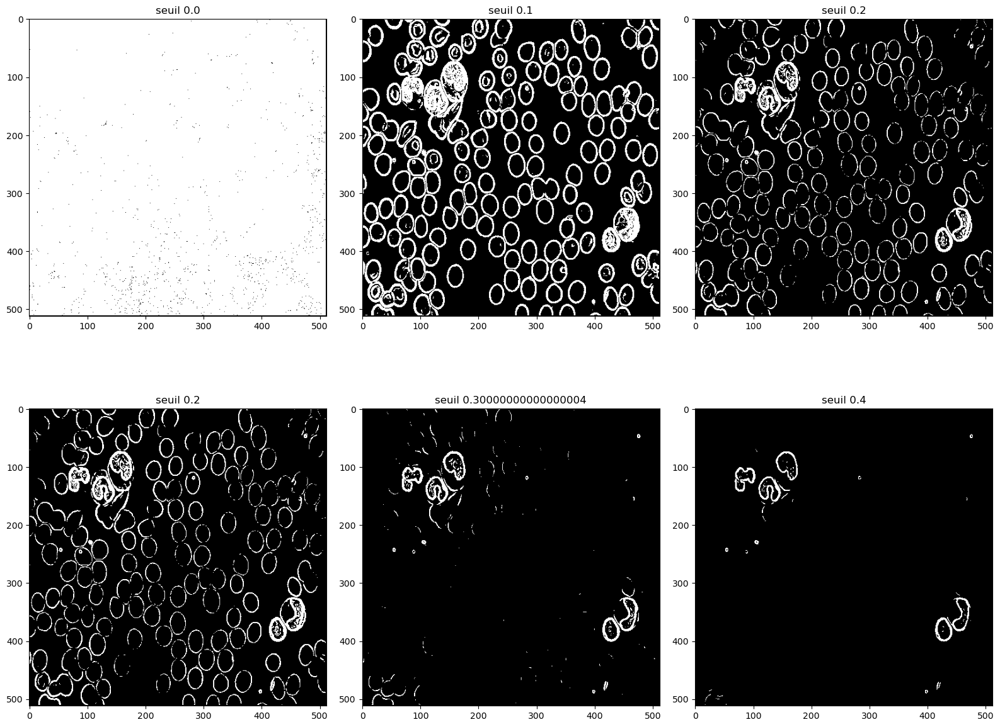

In [39]:
seuilnormes =np.linspace(0,0.5,6)
images=[]
for seuilnorm in seuilnormes :
    images.append(norme>seuilnorm)


fig,axes = plt.subplots(2,3,figsize=(16,13))

for i in range(2):
    for j in range(3) :
        axes[i,j].imshow(255*images[2*i+j],cmap='gray')
        axes[i,j].set_title(f'seuil {seuilnormes[2*i+j]}')
plt.tight_layout()
plt.show()

On remarque que pour une valeur nulle du seuil on obtien une image dans la quelle il existe plusieurs faux contours du à la presence du bruit qui fluctue la norme de gradient. On augmentatnt le bruit on constate qu'on élimine ce probleme (image 2 pour un seuil de 0.1) et on obtient une detection de contour la plus performantes avec des contours fermé. En augmentant encore la valeur de seuil on commence à perdre l'infromation et les contours diminuent et deviennent discontinues)

## 1.2 Maximum du gradient filtré dans la direction du gradient


Dans cette section on s'intéresse à la norme de gardient. On cherche à déterminer les pixels ayant la norme de gradient maximal dans la direction du gradient (on fera une interpolation bilénaire pour déterminer les valeurs de l'image norme) dans des position non entiere et on compare la valuer en ce pixel à deux valeurs voisine )


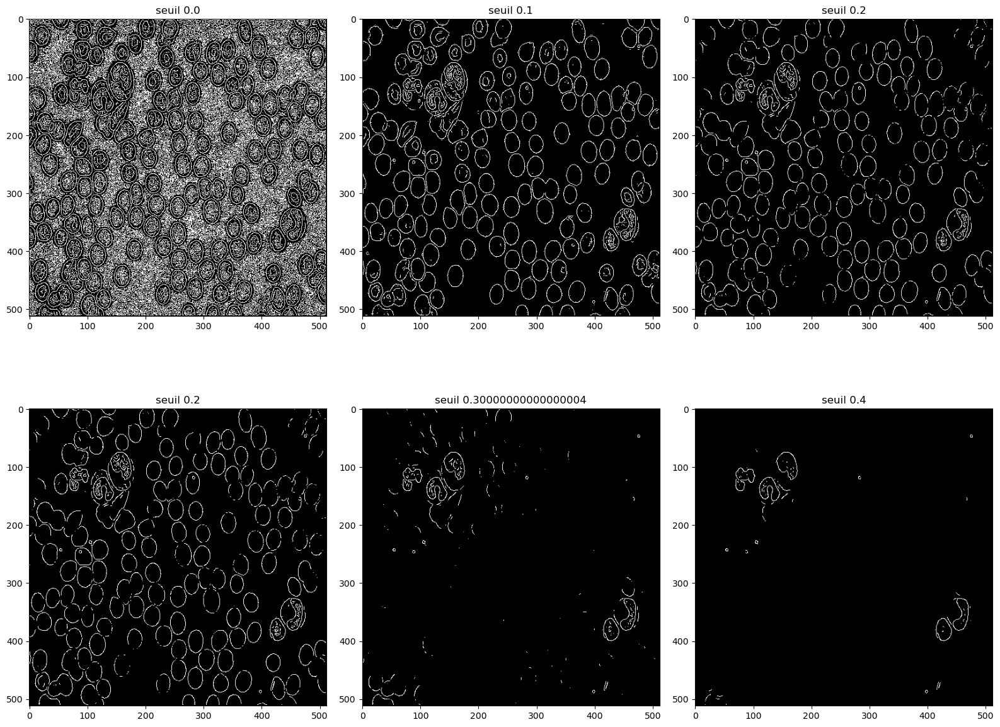

In [38]:
seuilnormes =np.linspace(0,0.5,6)
images=[]
for seuilnorm in seuilnormes :
    images.append((norme>seuilnorm)*contours)


fig,axes = plt.subplots(2,3,figsize=(16,13))

for i in range(2):
    for j in range(3) :
        axes[i,j].imshow(255*images[2*i+j],cmap='gray')
        axes[i,j].set_title(f'seuil {seuilnormes[2*i+j]}')
plt.tight_layout()
plt.show()

Le résultat de calcul des maxima de norme de gradient dans la direction de gradient sans seuillage donnent des résultat tres bruité. Après seuillage, on obtient une détection des contours plus claire avec des countours continues et trés peu de bruit (le meilleur résultat est pour un suil de 0.1). En augementant la valeur du seuil les countours diminuent et deviennent de plus en plus discountinues.

-> Meilleur résultat pour un seuil 0.1

## 1.3 Filtre récursif de Deriche

In [22]:
def dericheGradX(ima,alpha):
    nl,nc=ima.shape
    ae=math.exp(-alpha)
    c=-(1-ae)*(1-ae)/ae

    b1=np.zeros(nc)
    b2=np.zeros(nc)

    gradx=np.zeros((nl,nc))

    for i in range(nl):
        
        l=ima[i,:].copy()
        
        for j in range(2,nc):
            b1[j] = l[j-1]+2*ae*b1[j-1]-ae*ae*b1[j-2]     # LIGNE A MODIFIER
        b1[0]=b1[2]
        b1[1]=b1[2]
        
        for j in range(nc-3,-1,-1):
            b2[j] = l[j+1] + 2*ae*b2[j+1]-ae*ae*b2[j+2]    # LIGNE A MODIFIER
        b2[nc-2]=b2[nc-3]
        b2[nc-1]=b2[nc-3]

        gradx[i,:]=c*ae*(b1-b2);
  
    return gradx
        
def dericheGradY(ima,alpha):

    
    nl,nc=ima.shape
    ae=math.exp(-alpha)
    c=-(1-ae)*(1-ae)/ae

    b1=np.zeros(nl)
    b2=np.zeros(nl)

    grady=np.zeros((nl,nc))

    for i in range(nc):
        
        l=ima[:,i].copy()
        
        for j in range(2,nl):
            b1[j] = l[j-1]+2*ae*b1[j-1]-ae*ae*b1[j-2]    # LIGNE A MODIFIER
        b1[0]=b1[2]
        b1[1]=b1[2]      
        
        for j in range(nl-3,-1,-1):
             b2[j] = l[j+1] + 2*ae*b2[j+1]-ae*ae*b2[j+2]  # LIGNE A MODIFIER
        b2[nl-1]=b2[nl-3]
        b2[nl-2]=b2[nl-3]
        
        grady[:,i]=c*ae*(b1-b2);
           
    return grady

In [23]:
def deriche_filter(ima,alpha,seuilnorme=0.1):
    gradx=dericheGradY(ima,alpha)
    grady=dericheGradX(ima,alpha)
    norme=np.sqrt(gradx*gradx+grady*grady)
    direction=np.arctan2(grady,gradx)
    contoursnorme =(norme>seuilnorme) 
    contours=np.uint8(mr.maximaDirectionGradient(gradx,grady))    
    valcontours=(norme>seuilnorme)*contours
    return gradx,grady,norme,direction,contours,valcontours
ima=io.imread("cell.tif")
#celles = deriche_filter(ima,1)
ima2=io.imread("lena.tif")
#lena = deriche_filter(ima2,1)
ima3 = io.imread("cerveau.tif")
#cerveau = deriche_filter(ima3,1)

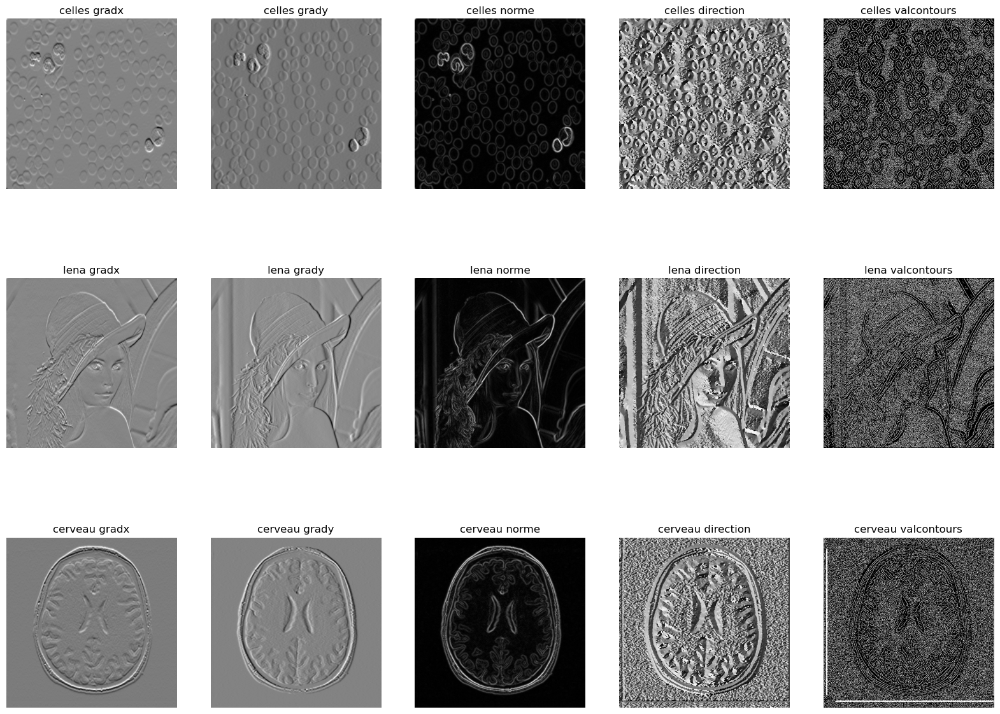

In [53]:
fig,axes = plt.subplots(3,5,figsize=(20,15))
titles=["gradx","grady","norme","direction","valcontours"]
for j in range (5) :
    axes[0,j].imshow(celles[j],cmap='gray')
    axes[1,j].imshow(lena[j],cmap='gray')
    axes[2,j].imshow(cerveau[j],cmap='gray')
    axes[0,j].set_title("celles "+titles[j])
    axes[1,j].set_title("lena "+titles[j])
    axes[2,j].set_title("cerveau "+titles[j])
for i in range (3):
    for j in range(5):
        axes[i,j].axis('off')
plt.show()

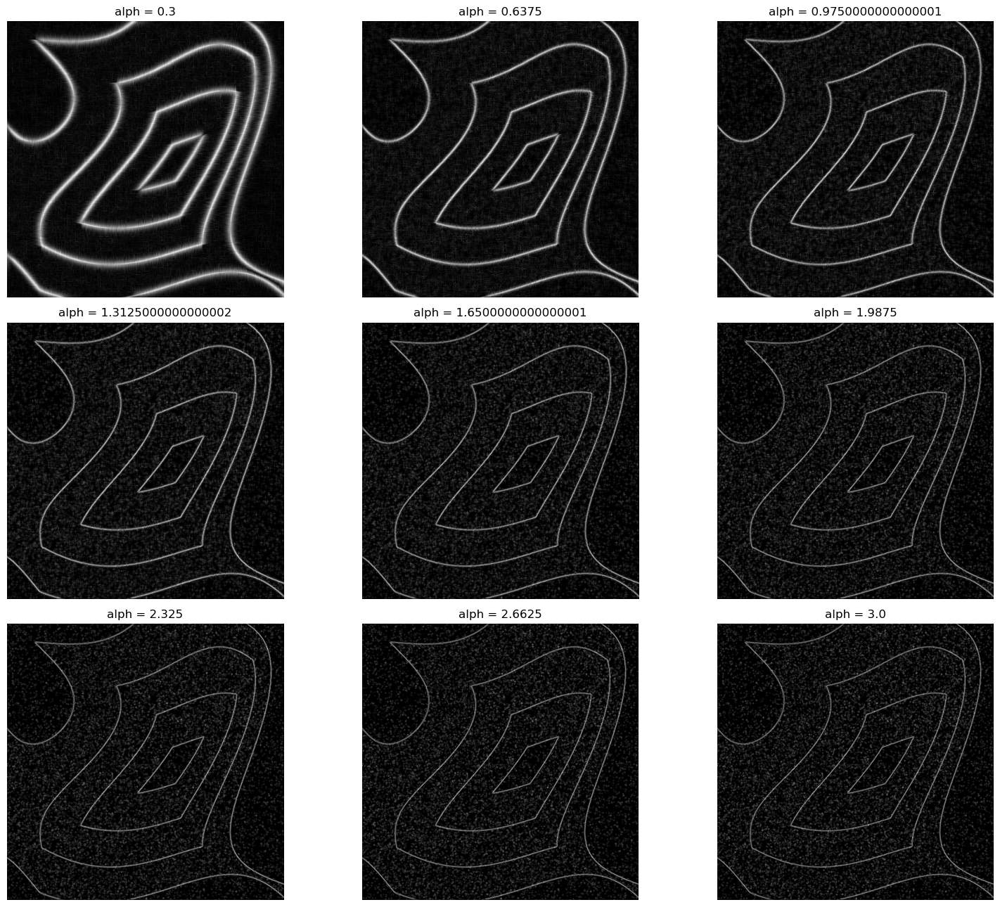

In [17]:
# testant maintenant l'influence de la valeur alpha 
ima_pyram = io.imread("pyrabruit.tif")
alphas = np.linspace(0.3,3.0,9)
pyram_images =[]
for alpha in alphas :
    pyram_images.append(deriche_filter(ima_pyram,alpha))
fig,axes=plt.subplots(3,3,figsize=(16,13))
for i in range (3):
    for j in range(3):
        axes[i,j].imshow(pyram_images[3*i+j][2],cmap="gray")
        axes[i,j].axis('off')
        axes[i,j].set_title(f"alph = {alphas[3*i+j]}")
plt.tight_layout()
plt.show()

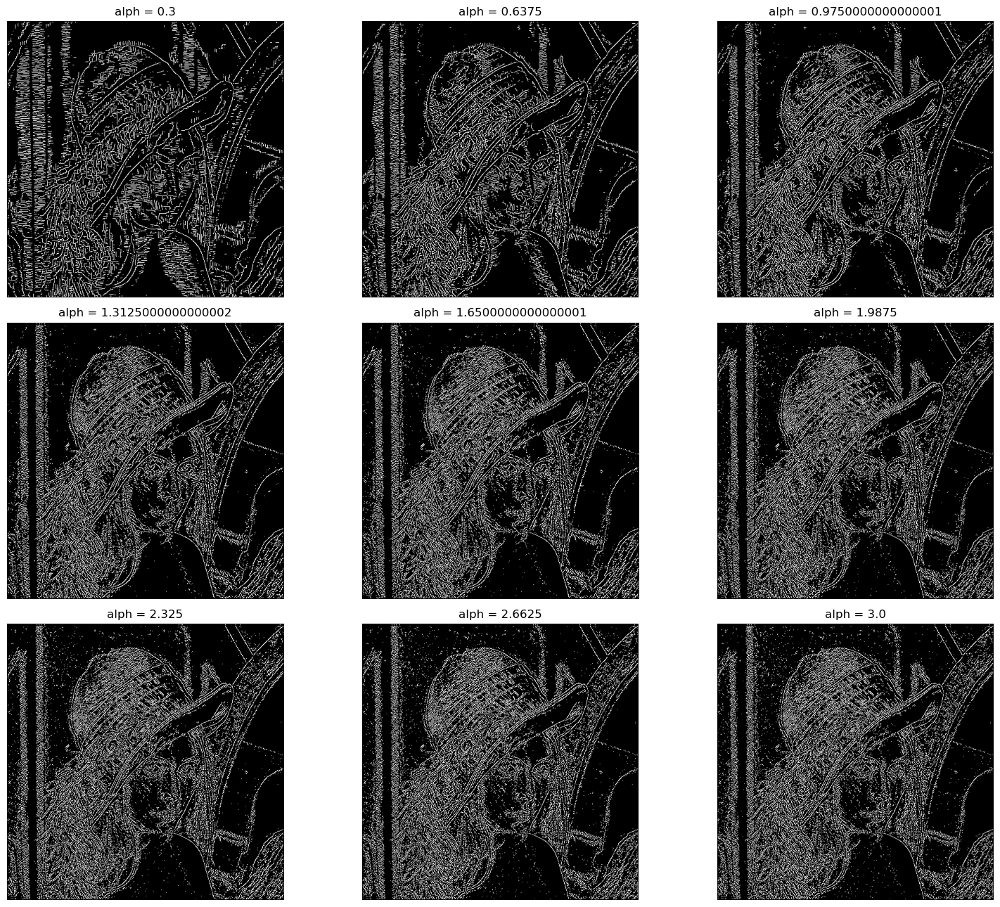

In [58]:
fig,axes=plt.subplots(3,3,figsize=(16,13))
for i in range (3):
    for j in range(3):
        axes[i,j].imshow((lena_images[3*i+j][2]>10)*lena_images[3*i+j][4],cmap="gray")
        axes[i,j].axis('off')
        axes[i,j].set_title(f"alph = {alphas[3*i+j]}")
plt.tight_layout()
plt.show()

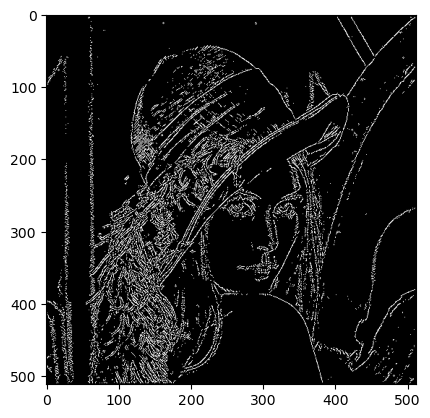

In [44]:
plt.imshow((lena_images[7][2]>22)*lena_images[7][4],cmap='gray')

Text(0.5, 1.0, 'après filtre')

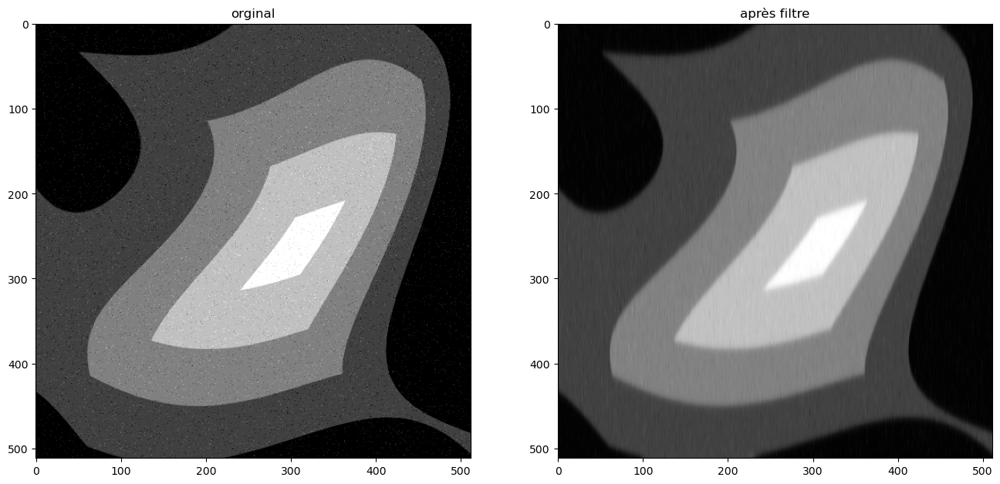

In [29]:
fig,axes = plt.subplots(1,2,figsize=(16,13))
axes[0].imshow(ima_pyram,cmap='gray')
axes[0].set_title("orginal")
axes[1].imshow(mr.dericheSmoothY(ima_pyram,alpha),cmap='gray')
axes[1].set_title("après filtre")

L'effet de alpha se manifeste dans la precision de la detection des contours. Pour alpha faible on detecte des contours flou mais on est robuste au bruits. En augmentant sa valeur on constante que les contours deviennet plus fines et on devient sensible aux bruits.

Non le temps de calcule ne dépend pas d'alpha. En effet alpha s'intervient seulement dans les constante multiplicatif (ae et c dans notre fonction) et donc n'infulence pas le nombre d'operation.

Deriche smoothX et smoothY ont le meme principe que le filtre de sobel. En efft, ils sert à faire un filtre passe bas dans la direction orthogonal. par example si on peut appliquer derichesmoothY en tant qu'un prétraitement de l'image avant d'appliquer deriche gradX

### 1.4 Passage par zéro du laplacien

In [20]:

ima=io.imread('cell.tif')
alpha=0.5

gradx=dericheGradX(mr.dericheSmoothY(ima,alpha),alpha)
grady=dericheGradY(mr.dericheSmoothX(ima,alpha),alpha)  

gradx2=dericheGradX(mr.dericheSmoothY(gradx,alpha),alpha)
grady2=dericheGradY(mr.dericheSmoothX(grady,alpha),alpha)  

lpima=gradx2+grady2

posneg=(lpima>=0)

nl,nc=ima.shape
contours=np.uint8(np.zeros((nl,nc)))


for i in range(1,nl):
    for j in range(1,nc):
        if (((i>0) and (posneg[i-1,j] != posneg[i,j])) or
            ((j>0) and (posneg[i,j-1] != posneg[i,j]))):
            contours[i,j]=255

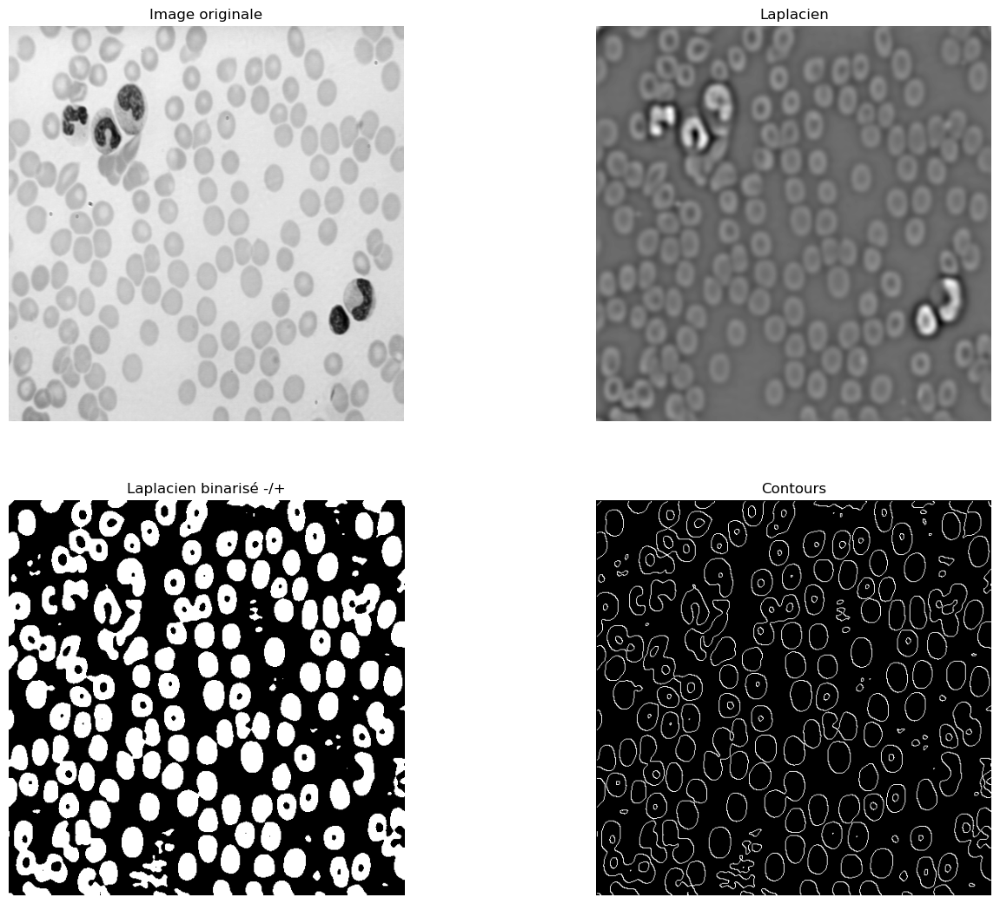

In [19]:
fig,axes = plt.subplots(2,2,figsize=(16,13))

axes[0,0].set_title('Image originale')
axes[0,0].imshow(ima, cmap='gray')

axes[0,1].set_title('Laplacien')
axes[0,1].imshow(lpima, cmap='gray')

axes[1,0].set_title('Laplacien binarisé -/+')
axes[1,0].imshow(255*posneg, cmap='gray')

axes[1,1].set_title('Contours')
axes[1,1].imshow(contours, cmap='gray')
for i in range (2):
    for j in range(2):
        axes[i,j].axis('off')

In [4]:
def compute_contour_laplace(ima,alpha):
    gradx=dericheGradX(mr.dericheSmoothY(ima,alpha),alpha)
    grady=dericheGradY(mr.dericheSmoothX(ima,alpha),alpha)  

    gradx2=dericheGradX(mr.dericheSmoothY(gradx,alpha),alpha)
    grady2=dericheGradY(mr.dericheSmoothX(grady,alpha),alpha)  

    lpima=gradx2+grady2

    posneg=(lpima>=0)

    nl,nc=ima.shape
    contours=np.uint8(np.zeros((nl,nc)))


    for i in range(1,nl):
        for j in range(1,nc):
            if (((i>0) and (posneg[i-1,j] != posneg[i,j])) or
                ((j>0) and (posneg[i,j-1] != posneg[i,j]))):
                contours[i,j]=255
    return contours

In [16]:
# influence de la valeur d'alpha 
alphas =np.linspace(0.3,3,3)
lina = io.imread("cell.tif")
countours=[]
for alpha in alphas :
    countours.append(compute_contour_laplace(ima,alpha))

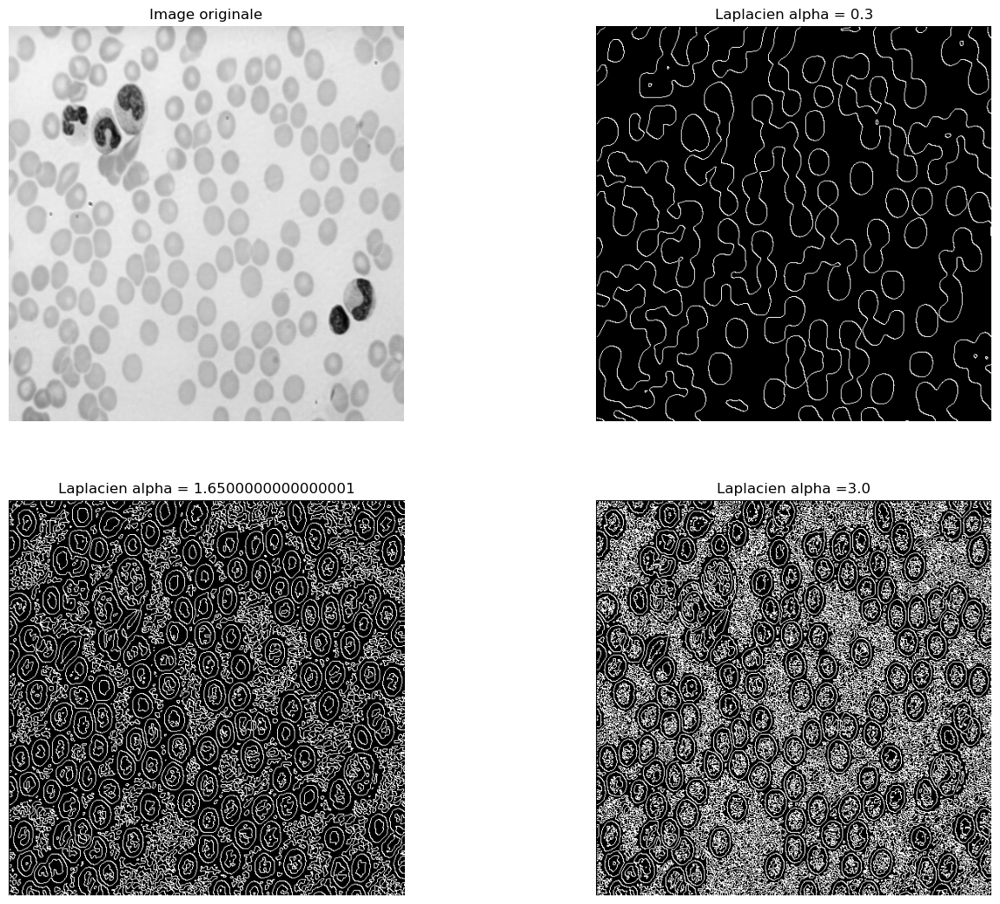

In [19]:
fig,axes = plt.subplots(2,2,figsize=(16,13))

axes[0,0].set_title('Image originale')
axes[0,0].imshow(lina, cmap='gray')

axes[0,1].set_title(f'Laplacien alpha = {alphas[0]}')
axes[0,1].imshow(countours[0], cmap='gray')

axes[1,0].set_title(f'Laplacien alpha = {alphas[1]}')
axes[1,0].imshow(countours[1], cmap='gray')

axes[1,1].set_title(f'Laplacien alpha ={alphas[2]}')
axes[1,1].imshow(countours[2], cmap='gray')
for i in range (2):
    for j in range(2):
        axes[i,j].axis('off')

La valeur d'alpha influence la sensibilité au bruits. En effet pour des valeurs faible de alpha on remarque que les images sont moins bruité que pour les valeurs plus fortes mais on perd en terme de precision de detection des contours.

La principle difference est l'apparition des nouvelles contours qui ne sont pas réellement un contour dans l'image de celle originale. En effet, ce sont des faux contours qui representent un passage de derivé seconde par zero mais pas necissairement d'un contour puisque en ces points on peut avoir un minimuim de gradient et pas un maximum. comme dans la partie montré dans la figure suivante :

<table><tr>
<td> <img src="capture/2.PNG" alt="Drawing" style="width: 400px;"/>  <p><center>prtion de l'image original</center></p> </td> 
   
<td> <img src="capture/1.PNG" alt="Drawing" style="width: 400px;"/>  <p><center>meme protion apres la detection de contour</center></p> </td> 
    
</tr></table>


Pour résoudre ce probleme on peut calculer le gradien dans les zones correspondantes aux passage par zero de laplacien et on vérifie que ses valeurs sont bien superieurs aux valeurs voisine autrement dits des maximaux locaux. donc en ce qui suit on va ajouter dans la conditions de verification finale de la fonction une autre condition qui necissite que si on a un passage par zero du laplacien on doit verifié que la norme de gradient est maximal dans l'une des deux dirction


In [5]:
alpha =0.5
ima=io.imread("pyramide.tif")
def compute_contour_laplace_modifie(ima,alpha):
    gradx=dericheGradX(mr.dericheSmoothY(ima,alpha),alpha)
    grady=dericheGradY(mr.dericheSmoothX(ima,alpha),alpha)  

    gradx2=dericheGradX(mr.dericheSmoothY(gradx,alpha),alpha)
    grady2=dericheGradY(mr.dericheSmoothX(grady,alpha),alpha)  

    lpima=gradx2+grady2

    posneg=(lpima>=0)

    nl,nc=ima.shape
    contours=np.uint8(np.zeros((nl,nc)))


    for i in range(1,nl-1):
        for j in range(1,nc-1):
            if (((i>0) and (posneg[i-1,j] != posneg[i,j])) or
                ((j>0) and (posneg[i,j-1] != posneg[i,j]))):
                norme11=gradx[i,j]**2 +grady[i,j]**2
                norme01=gradx[i-1,j]**2 +grady[i-1,j]**2
                norme10=gradx[i,j-1]**2 +grady[i,j-1]**2
                norme12=gradx[i,j+1]**2 +grady[i,j+1]**2
                norme21=gradx[i+1,j]**2 +grady[i+1,j]**2
                if(((norme11>=norme10) and (norme11>=norme12)) or ((norme11>=norme21) and (norme11>=norme01))) :

                        contours[i,j]=255
    return contours

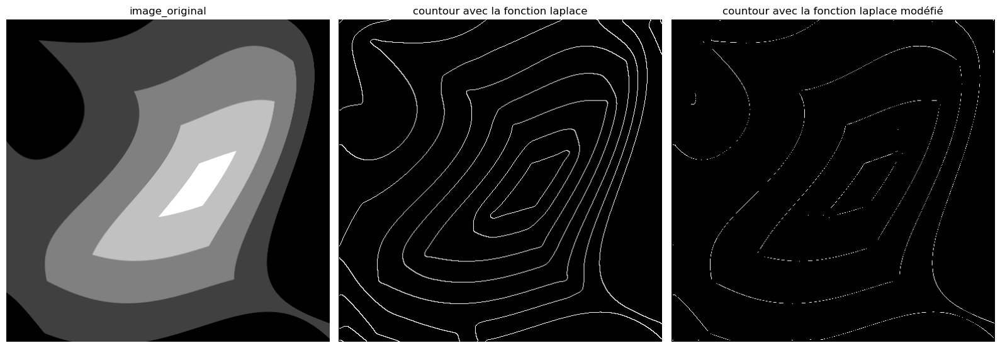

In [59]:
countour1= compute_contour_laplace(ima,alpha)
contous =  compute_contour_laplace_modifie(ima,alpha)
fig,axes = plt.subplots(1,3,figsize=(16,13))
axes[0].imshow(ima,cmap='gray')
axes[0].set_title("image_original")
axes[1].imshow(countour1,cmap="gray")
axes[1].set_title("countour avec la fonction laplace")
axes[2].imshow(contours,cmap='gray')
axes[2].set_title("countour avec la fonction laplace modéfié")
for i in range(3):
    axes[i].axis("off")
plt.tight_layout()

### 1.5 Changez d’image


In [95]:
ima = io.imread("pyra-gauss.tif")
ima_deriche=deriche_filter(ima,0.3,0.1*255)
ima_laplace=compute_contour_laplace(ima,0.5)
ima_laplace2=compute_contour_laplace_modifie(ima,0.5)

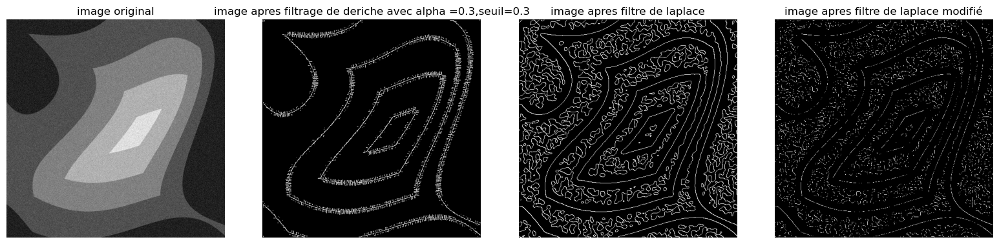

In [96]:
fig,axes = plt.subplots(1,4,figsize=(16,13))
axes[0].imshow(ima,cmap='gray')
axes[0].set_title('image original')
axes[1].imshow(ima_deriche[5],cmap='gray')
axes[1].set_title("image apres filtrage de deriche avec alpha =0.3,seuil=0.3")
axes[2].imshow(ima_laplace,cmap='gray')
axes[2].set_title('image apres filtre de laplace')
axes[3].imshow(ima_laplace2,cmap='gray')
axes[3].set_title('image apres filtre de laplace modifié')
plt.tight_layout()
for i in range (4):
    axes[i].axis('off')

Pour segmenter cette image on prefère utilisé le filtre de deriche avec un seuil adequats puisqu'il est moins sensible aux bruits gaussien.
Pour le traitement on peut appliquer un filtre moyenneur pour reduire le bruit de l'image comme on a fait dans le TP2
Pour le postraitement on peut faire un seuillage ou bien utiliser un algorithme pour remidier aux probleme liée à la discontinuité eventuelle des contours.

In [6]:
def get_cst_ker(t):
    return np.ones((t,t))/t**2

def filtre_lineaire(im,mask):
    """ renvoie la convolution de l'image avec le mask. Le calcul se fait en 
utilisant la transformee de Fourier et est donc circulaire.  Fonctionne seulement pour 
les images en niveau de gris.
"""
    fft2=np.fft.fft2
    ifft2=np.fft.ifft2
    (y,x)=im.shape
    (ym,xm)=mask.shape
    mm=np.zeros((y,x))
    mm[:ym,:xm]=mask
    fout=(fft2(im)*fft2(mm))
    # on fait une translation pour ne pas avoir de decalage de l'image
    # pour un mask de taille impair ce sera parfait, sinon, il y a toujours un decalage de 1/2
    mm[:ym,:xm]=0
    y2=int(np.round(ym/2-0.5))
    x2=int(np.round(xm/2-0.5))
    mm[y2,x2]=1
    out=np.real(ifft2(fout*np.conj(fft2(mm))))
    return out

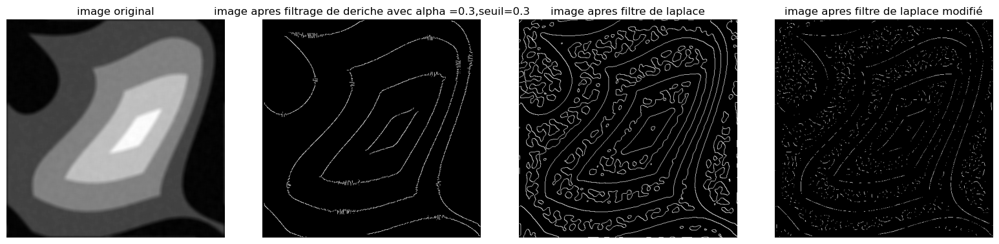

In [101]:
kernel = get_cst_ker(11)
filtred_ima = filtre_lineaire(ima,kernel)
ima_deriche=deriche_filter(filtred_ima,0.3,0.1*255)
ima_laplace=compute_contour_laplace(filtred_ima,0.5)
ima_laplace2=compute_contour_laplace_modifie(filtred_ima,0.5)

# viewing results 
fig,axes = plt.subplots(1,4,figsize=(16,13))
axes[0].imshow(filtred_ima,cmap='gray')
axes[0].set_title('image filtré')
axes[1].imshow(ima_deriche[5],cmap='gray')
axes[1].set_title("image apres filtrage de deriche avec alpha =0.3,seuil=0.3")
axes[2].imshow(ima_laplace,cmap='gray')
axes[2].set_title('image apres filtre de laplace')
axes[3].imshow(ima_laplace2,cmap='gray')
axes[3].set_title('image apres filtre de laplace modifié')
plt.tight_layout()
for i in range (4):
    axes[i].axis('off')

On remarque qu'apres un simple filtrage avec un noyeau constant les resultat sont plus précise.

##  2-Seuillage avec hystérésis

### 2.1 Application à la détection de lignes

In [7]:
from scipy import ndimage as ndi
def tophat(im,rayon):
    se=morpho.square(rayon)
    ero=morpho.erosion(im,se)
    dil=morpho.dilation(ero,se)
    tophat=im-dil
    return tophat

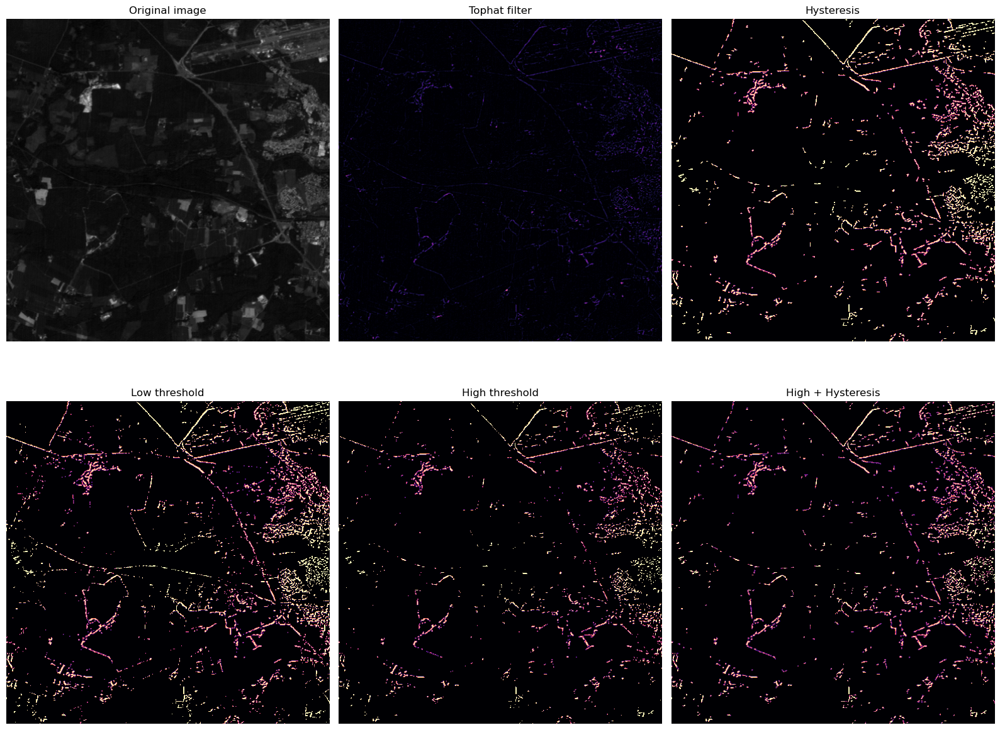

In [111]:
fig, ax = plt.subplots(nrows=2, ncols=3,figsize=(16,13))

ima =io.imread('spot.tif');
rayon=3
top=tophat(ima,rayon)

low = 3
high = 5


lowt = (top > low).astype(int)
hight = (top > high).astype(int)
hyst = filters.apply_hysteresis_threshold(top, low, high)


ax[0, 0].imshow(ima, cmap='gray')
ax[0, 0].set_title('Original image')

ax[0, 1].imshow(top, cmap='magma')
ax[0, 1].set_title('Tophat filter')

ax[1, 0].imshow(lowt, cmap='magma')
ax[1, 0].set_title('Low threshold')

ax[1, 1].imshow(hight, cmap='magma')
ax[1, 1].set_title('High threshold')

ax[0, 2].imshow(hyst, cmap='magma')
ax[0, 2].set_title('Hysteresis')

ax[1, 2].imshow(hight + hyst, cmap='magma')
ax[1, 2].set_title('High + Hysteresis')

for a in ax.ravel():
    a.axis('off')

plt.tight_layout()

plt.show()


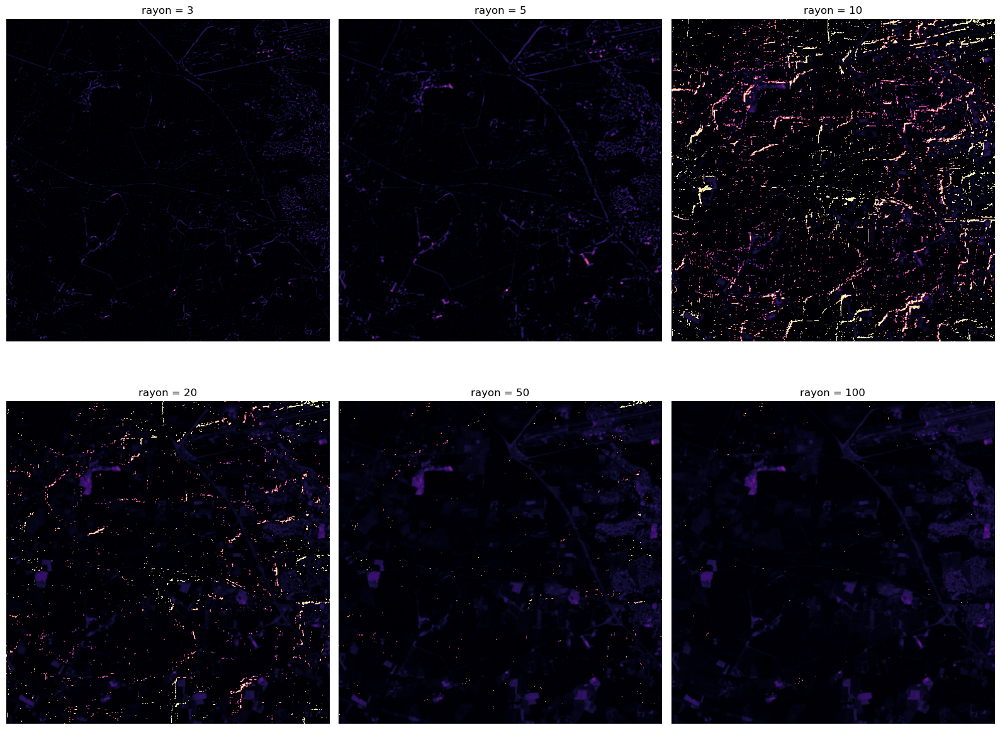

In [134]:
rayons=[3,5,10,20,50,100]
tops=[]
for rayon in rayons :
    tops.append(tophat(ima,rayon))
fig,axes=plt.subplots(2,3,figsize=(16,13))
for i in range(2):
    for j in range (3):
        axes[i,j].imshow(tops[3*i+j],cmap='magma')
        axes[i,j].axis('off')
        axes[i,j].set_title(f"rayon = {rayons[3*i+j]}")
plt.tight_layout()

en faisant augmenter le rayon on remarque qu'on devient plus sensible au bruit et on detecte non plus des lignes continues seulement mais aussi des points (visible pour le rayon 10 et 20), on augmentant encorela valuer de la fenetre on s'approche de plus en plus à l'image original.

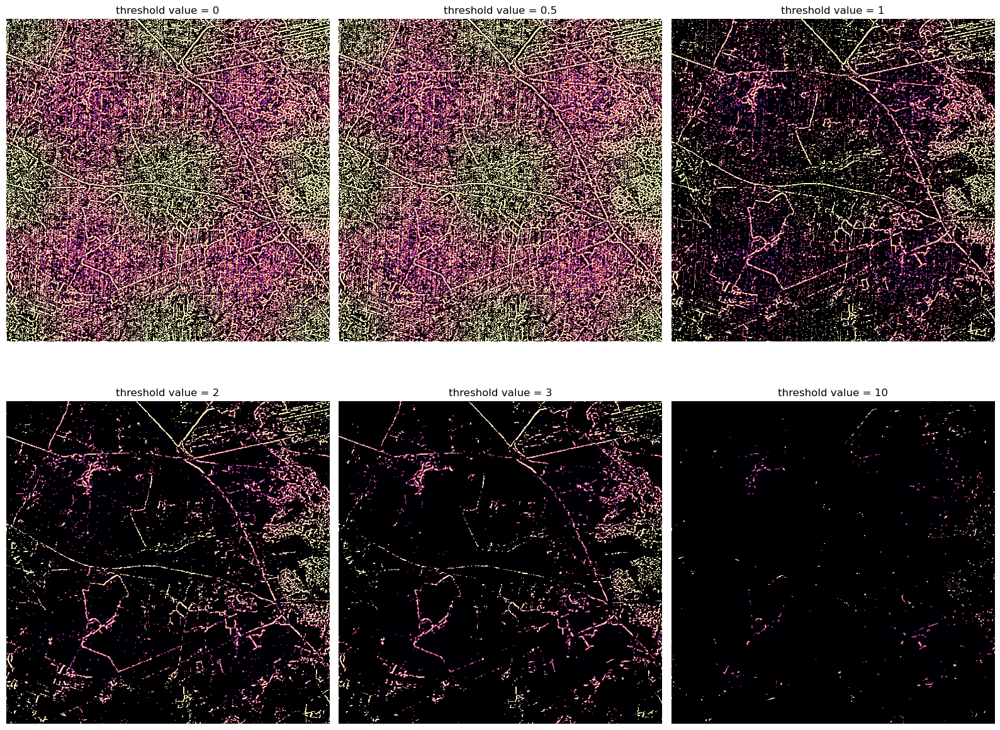

In [140]:
lows=[0,0.5,1,2,3,10]
images_low=[]
for low in lows :
    images_low.append ((top > low).astype(int))
fig,axes=plt.subplots(2,3,figsize=(16,13))
for i in range(2):
    for j in range (3):
        axes[i,j].imshow(images_low[3*i+j],cmap='magma')
        axes[i,j].axis('off')
        axes[i,j].set_title(f"threshold value = {lows[3*i+j]}")
plt.tight_layout()

ici on remarque que la meilleur valeur de seuil low est 2

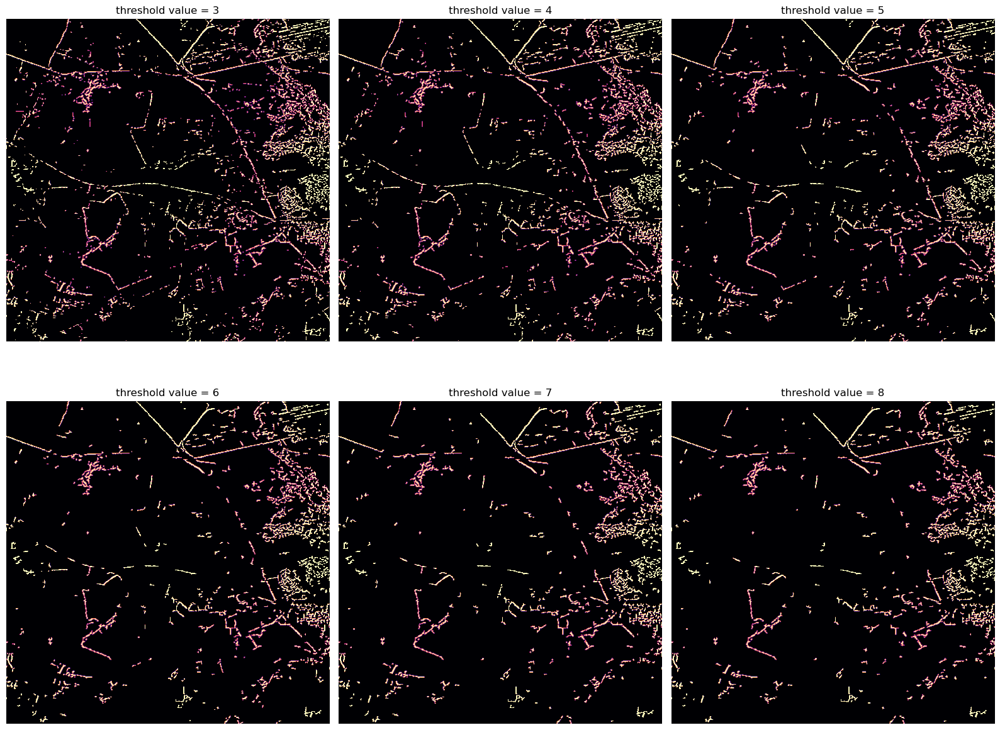

In [143]:
highs=[3,4,5,6,7,8]
images_hyster=[]
for high in highs :
    images_hyster.append (filters.apply_hysteresis_threshold(top, 2, high))
fig,axes=plt.subplots(2,3,figsize=(16,13))
for i in range(2):
    for j in range (3):
        axes[i,j].imshow(images_hyster[3*i+j],cmap='magma')
        axes[i,j].axis('off')
        axes[i,j].set_title(f"threshold value = {highs[3*i+j]}")
plt.tight_layout()

Pour le suil haut il est claire qu'en augmentant la valeur de ce seuil on obtient de plus en plus de discontinuité. Donc la meilleur valeur dans notre cas est 3 (meme si on a presence de bruit).

Pour la question suivante on choisit la methode de filtre de deriche et on lui ajoute le suillage d'hystérésis puis on l'applique pour trois images differente 

In [8]:
def deriche_filter_hysteris(ima,alpha,low,high):
    gradx=dericheGradY(ima,alpha)
    grady=dericheGradX(ima,alpha)
    norme=np.sqrt(gradx*gradx+grady*grady)
    direction=np.arctan2(grady,gradx)
    top=tophat(norme,3)
    contoursnorme =filters.apply_hysteresis_threshold(top,low,high) 
    contours=np.uint8(mr.maximaDirectionGradient(gradx,grady))    
    valcontours = contoursnorme * contours
    return norme,contoursnorme,contours,valcontours

In [147]:
ima =io.imread("pyramide.tif")
ima2=io.imread("lena.tif")
ima3=io.imread("cell.tif")
ima_l=deriche_filter_hysteris(ima,0.6,2,3)
ima_l2=deriche_filter_hysteris(ima2,0.6,6,7)
ima_l3=deriche_filter_hysteris(ima3,0.6,2,3)

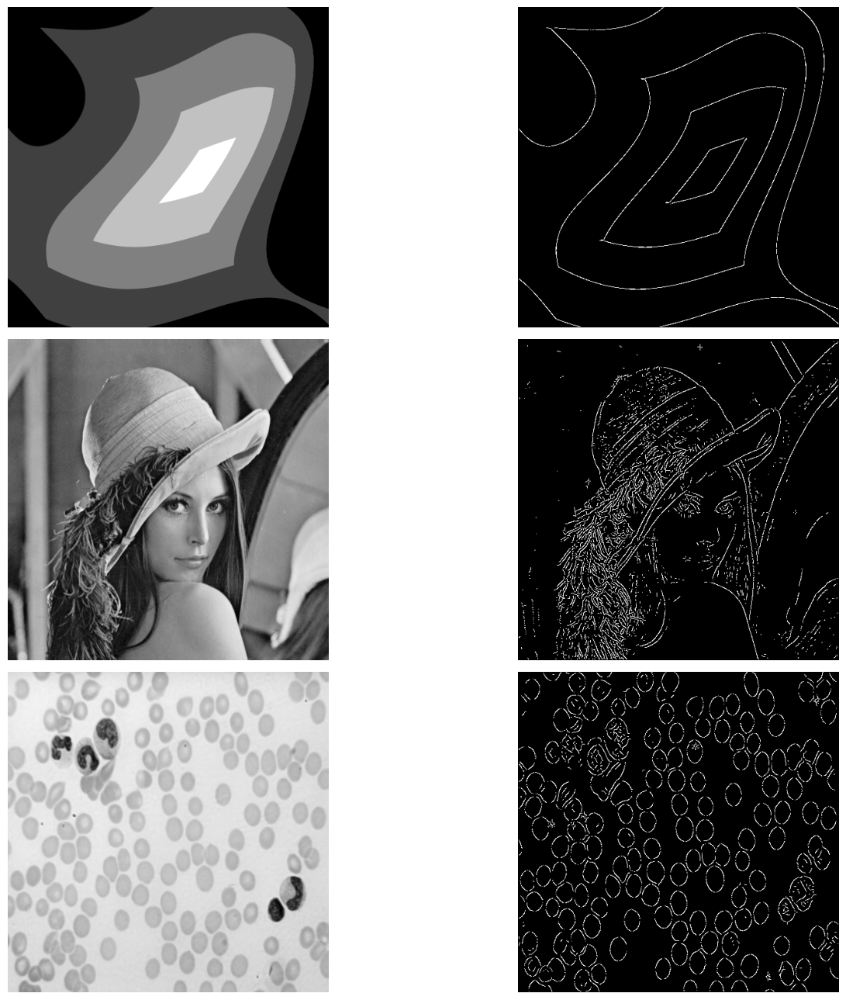

In [149]:
fig,axes = plt.subplots(3,2,figsize=(16,13))
axes[0,0].imshow(ima,cmap='gray')
axes[0,1].imshow(ima_l[3],cmap='gray')
axes[1,0].imshow(ima2,cmap='gray')
axes[1,1].imshow(ima_l2[3],cmap='gray')
axes[2,0].imshow(ima3,cmap='gray')
axes[2,1].imshow(ima_l3[3],cmap='gray')
for a in axes.ravel():
    a.axis('off')
plt.tight_layout()

## 3-Segmentation par classification : K-moyennes

### 3.1 Image de niveau de gris

Fitting model on a small sub-sample of the data
done in 0.242s.
Predicting color indices on the full image (k-means)
done in 0.006s.


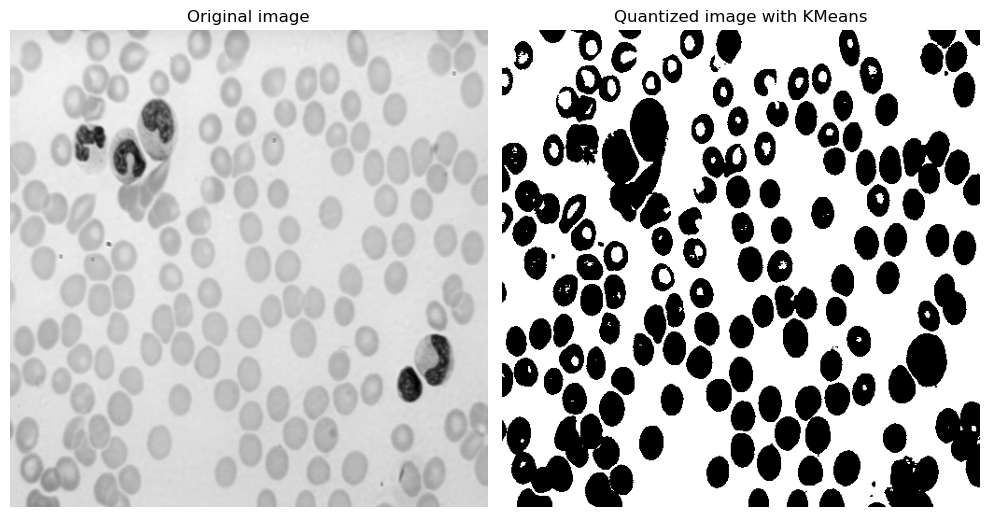

In [14]:

# Ignore a specific warning by message
warnings.filterwarnings('ignore')

n_class = 2
ima=io.imread('cell.tif')
    
def recreate_image(codebook, labels, w, h):
        """Recreate the (compressed) image from the code book & labels"""
        image = np.zeros((w, h))
        label_idx = 0
        for i in range(w):
            for j in range(h):
                image[i][j] = codebook[labels[label_idx]]
                label_idx += 1
        return image


def apply_kmeans1(ima,n_class) :
    # Convert to floats instead of the default 8 bits integer coding. Dividing by
    # 255 is important so that plt.imshow behaves works well on float data (need to
    # be in the range [0-1])
    ima = np.array(ima, dtype=np.float64) / 255

    # Load Image and transform to a 2D numpy array.
    w, h = original_shape = tuple(ima.shape)
    d = 1
    image_array = np.reshape(ima, (w * h, d))

    print("Fitting model on a small sub-sample of the data")
    t0 = time()
    image_array_sample = shuffle(image_array, random_state=0)[:1000]
    kmeans = KMeans(n_clusters=n_class, random_state=50).fit(image_array_sample)
    print("done in %0.3fs." % (time() - t0))

    # Get labels for all points
    print("Predicting color indices on the full image (k-means)")
    t0 = time()
    labels = kmeans.predict(image_array)
    print("done in %0.3fs." % (time() - t0))
    
    # Display all results, alongside original image

    fig,axes = plt.subplots(1,2,figsize=(10,8))

    axes[0].axis('off')
    axes[0].set_title('Original image')
    axes[0].imshow(ima,cmap='gray')

    axes[1].axis('off')
    axes[1].set_title('Quantized image with KMeans')
    axes[1].imshow(recreate_image(kmeans.cluster_centers_, labels, w, h),cmap='gray')
    plt.tight_layout()
    plt.show()
apply_kmeans1(ima,n_class)

Non cette méthode ne segmente pas correctement les differents types de cellules. En effet, on peut remarquer 2 problèmes. Le premier est que dans l'image on a 3 choses à segmenter : le fond de l'image + 2 types de cellules. Donc la supposition qu'on a 2 classe est fausse. Le deuxieme probleme est que pour certaines cellules on a un interieur que notre methode classe comme un fond ce qui est faux car l'interieur d'une cellule appartient à la cellule.
Pour remider au premier problème on peut augmenter le nombre de classe à 3 pour avoir un mieux classement

Fitting model on a small sub-sample of the data
done in 0.061s.
Predicting color indices on the full image (k-means)
done in 0.004s.


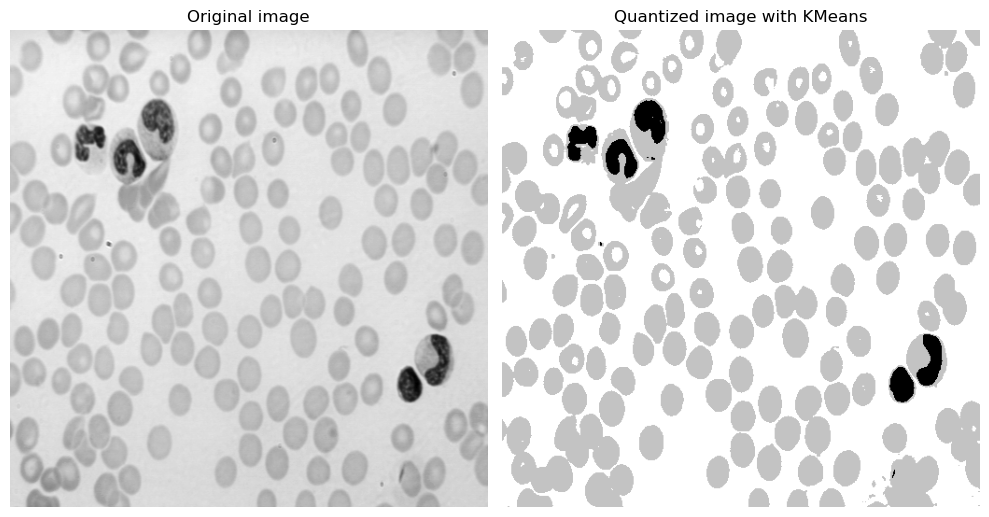

In [65]:
#n_class = 3
apply_kmeans1(ima,n_class=3)

Comme prévu, en augmentant le nombre de classe à trois on parvient de bien distinguer les zones qui contiennent des anomalies dans les cellules.

Fitting model on a small sub-sample of the data
done in 0.077s.
Predicting color indices on the full image (k-means)
done in 0.006s.


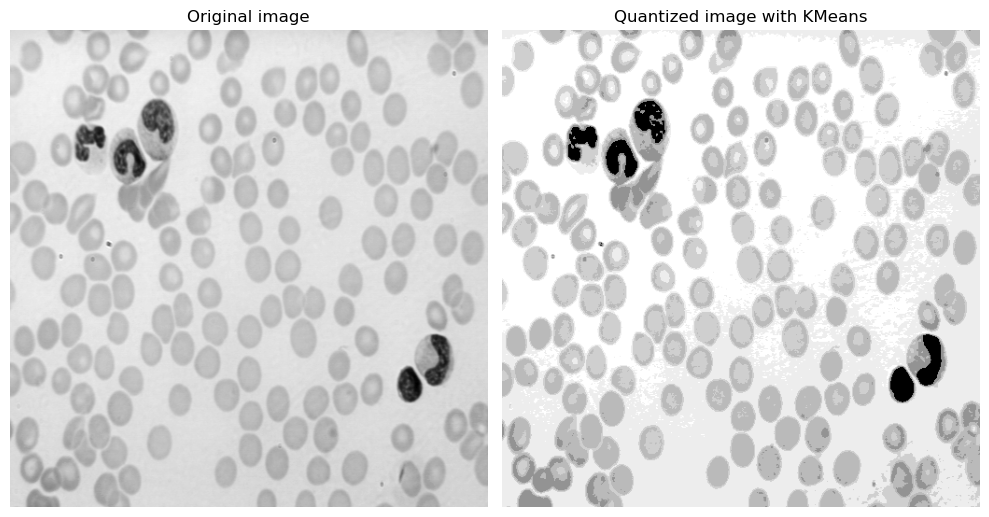

In [39]:
#n_class = 6
apply_kmeans1(ima,6)

En augmementant encore le nombre de classe on obtient des nouvelles classification don't on n'a pas besoin. Et les differents classes ne peuvent pas etre associé à des choses explicable (on ne peut pas dire qu'une classe est associé à un type de cellule)

En ce qui concerne l'intialisation, les options presentent sont soit l'intialisation aléatoire comme on a fait precedement soit en utilisant k-means++ : Il fait un calcule de probabilité. Si le point c’est loin des centroids que on a déjà
choisir, il y a une grande probabilité, si non, un petit. Donc nous avons une probabilité plus grande de
commencer l’algorithme avec un centre en chaque cluster. Normalement, il donne des meilleurs résultats.
    Enfin, il ya la possibilité de donner les points intiale. En ce qui suit on va montrer que avec des centroide intiales particulier on va tomber sur un minimuim local qui donne une mauvaise segmentation.

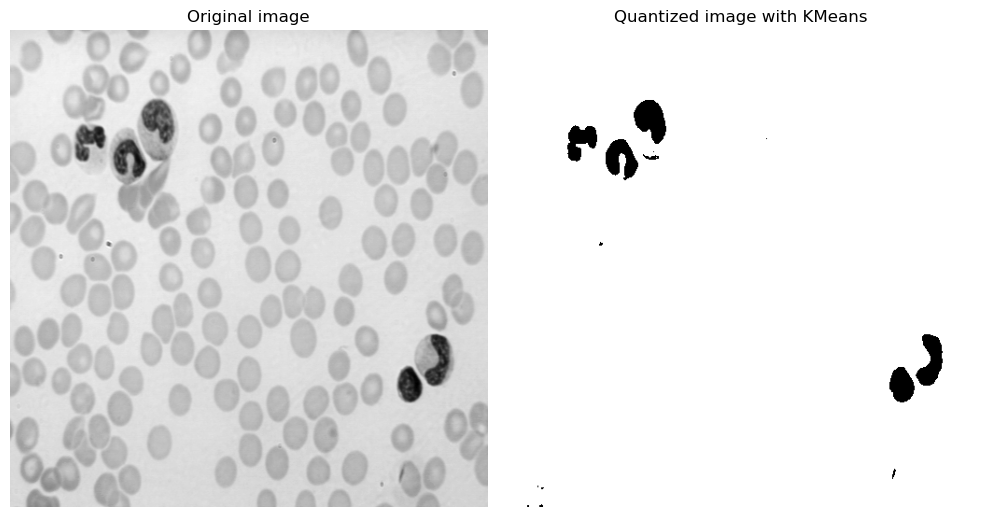

In [40]:
if (True) :   
    # Convert to floats instead of the default 8 bits integer coding. Dividing by
    # 255 is important so that plt.imshow behaves works well on float data (need to
    # be in the range [0-1])
    n_cluster =2
    ima = np.array(ima, dtype=np.float64) / 255

    # Load Image and transform to a 2D numpy array.
    w, h = original_shape = tuple(ima.shape)
    d = 1
    image_array = np.reshape(ima, (w * h, d))

    #print("Fitting model on a small sub-sample of the data")
    t0 = time()
    image_array_sample = shuffle(image_array, random_state=0)[:1000]
    kmeans = KMeans(n_clusters=n_class,init=np.array([[0.7],[0.8]]), random_state=0).fit(image_array_sample)
    #print("done in %0.3fs." % (time() - t0))

    # Get labels for all points
    #print("Predicting color indices on the full image (k-means)")
    t0 = time()
    labels = kmeans.predict(image_array)
    #print("done in %0.3fs." % (time() - t0))
    
    # Display all results, alongside original image

    fig,axes = plt.subplots(1,2,figsize=(10,8))

    axes[0].axis('off')
    axes[0].set_title('Original image')
    axes[0].imshow(ima,cmap='gray')

    axes[1].axis('off')
    axes[1].set_title('Quantized image with KMeans')
    axes[1].imshow(recreate_image(kmeans.cluster_centers_, labels, w, h),cmap='gray')
    plt.tight_layout()
    plt.show()

En choisissant un nombre de classe egale à 2 comme dans le premier essai et on choisissant deux centroides spécifique (non aléatoirement comme precedement) qui sont les deux niveaux de gris 0.7 et 0.8, on remarque qu'on obtient une mauvaise classification de l'image qui diffère énormement au resultat de premier essai malgrés qu'on a utilisé le meme algorithme avec le meme nombre de classe. Ceci montre que l'algorithme de K-means est sensible à l'intialisation 

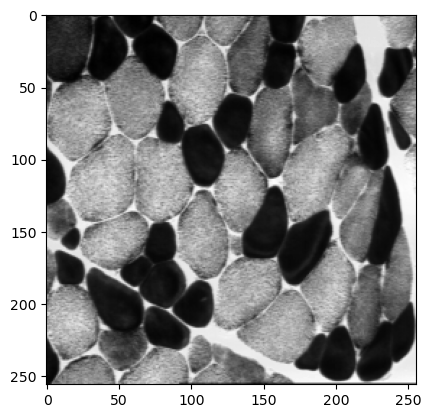

In [67]:
ima=io.imread('muscle.tif')
plt.imshow(ima,cmap='gray');

Pour l'image de muscle on peut dire qu'on a 3 classe, les cellule claire , les cellules noire et le fond.
On va donc tester avec 3 classe et voire les résultat.

Fitting model on a small sub-sample of the data
done in 0.057s.
Predicting color indices on the full image (k-means)
done in 0.002s.


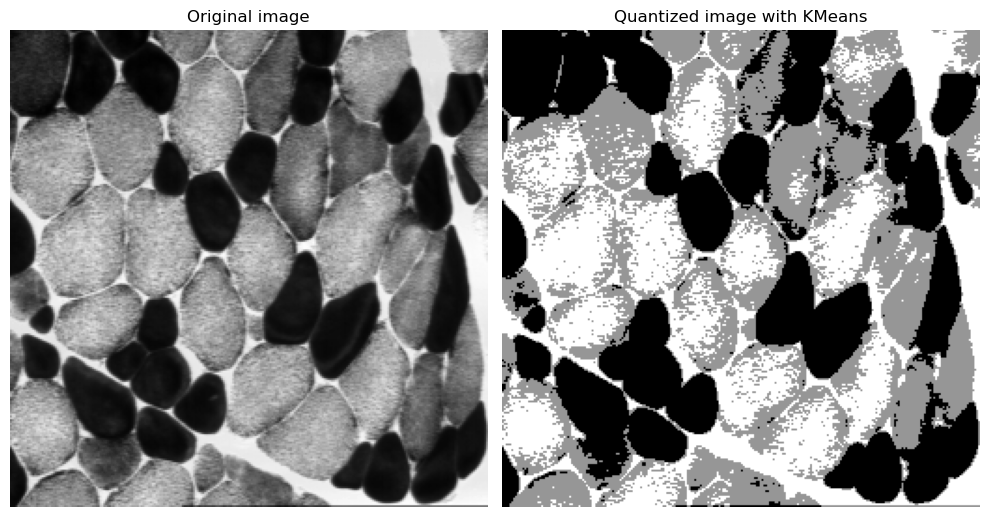

In [68]:
apply_kmeans1(ima,3)

Dans cette image, meme avec un nombre de classe connu et une bonne initialisation de l'algorithm on remarque que les cellules de couleur gris clair sont mal classé. En effet ces cellules ne présentent pas le meme niveau de gris et comprennent plusieurs niveau. Et puisque l'algorithm de k-means ne tient pas compte de la coherence spatial le résultat sera basé uniquement sur le niveau de gris du pixel. Donc on aure des pixel mal classé meme s'il sont à l'interieur d'une cellule.

En appliquant un filtrage moyenne on va diminuer la variance dans l'image (comme on fair pour le débruitage) puisqu'on applique un filtre passe bas qui adoucie le bruit et les changements à niveau de gris très brutale. Le resultat sera donc plus homogenes dans les zones semblable (comme dans le cas de l'interieur d'une cellule) ce qui va améliorer la qualité de la segementation avec le k-means.

### 3.2-Image en couleur

In [79]:
def recreate_image(codebook, labels, w, h):
    """Recreate the (compressed) image from the code book & labels"""
    d = codebook.shape[1]
    image = np.zeros((w, h, d))
    label_idx = 0
    for i in range(w):
        for j in range(h):
            image[i][j] = codebook[labels[label_idx]]
            label_idx += 1
    return image
def apply_kmeans3(ima,n_colors):
    # Convert to floats instead of the default 8 bits integer coding. Dividing by
    # 255 is important so that plt.imshow behaves works well on float data (need to
    # be in the range [0-1])
    ima = np.array(ima, dtype=np.float64) / 255

    # Load Image and transform to a 2D numpy array.
    w, h, d = original_shape = tuple(ima.shape)
    assert d == 3
    image_array = np.reshape(ima, (w * h, d))

    print("Fitting model on a small sub-sample of the data")
    t0 = time()
    image_array_sample = shuffle(image_array, random_state=0)[:1000]
    kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(image_array_sample)
    print("done in %0.3fs." % (time() - t0))

    # Get labels for all points
    print("Predicting color indices on the full image (k-means)")
    t0 = time()
    labels = kmeans.predict(image_array)
    print("done in %0.3fs." % (time() - t0))

    # Display all results, alongside original image
    fig,axes= plt.subplots(1,2,figsize =(16,13))
    axes[0].axis('off')
    axes[0].set_title('Original image')
    axes[0].imshow(ima)

    axes[1].axis('off')
    axes[1].set_title('Quantized image with K-Means: %i colours' %n_colors)
    axes[1].imshow(recreate_image(kmeans.cluster_centers_, labels, w, h))

Fitting model on a small sub-sample of the data
done in 0.148s.
Predicting color indices on the full image (k-means)
done in 0.008s.


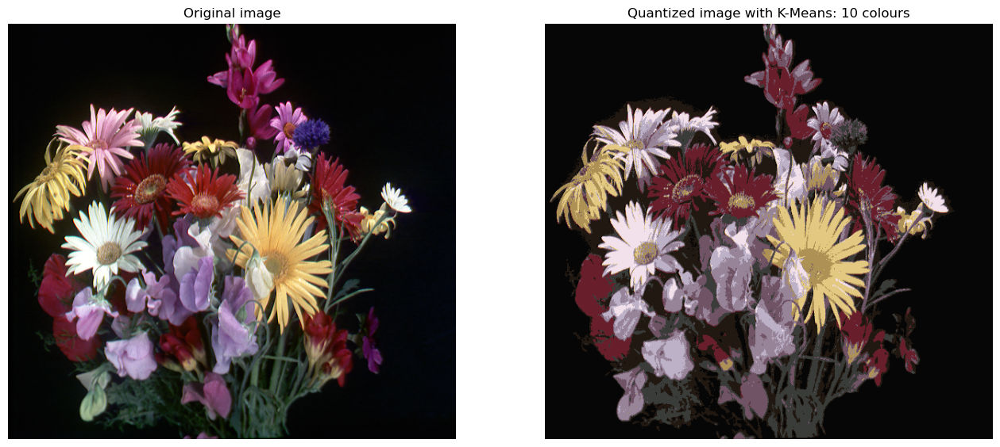

In [80]:
ima=io.imread("fleur.tif")
apply_kmeans3(ima,10)

Pour un nombre de class = 10 on obtient un résultat acceptable mais on a perdu beaucoup de couleurs qui appraissent dans des petites zones telles que le mauve et le bleu par example.

Fitting model on a small sub-sample of the data
done in 0.101s.
Predicting color indices on the full image (k-means)
done in 0.008s.


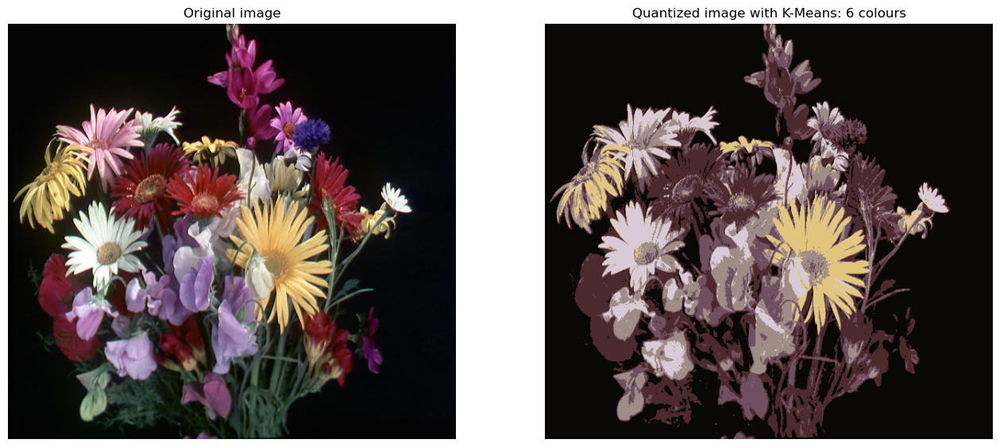

In [99]:
apply_kmeans3(ima,6)

Fitting model on a small sub-sample of the data
done in 0.101s.
Predicting color indices on the full image (k-means)
done in 0.009s.


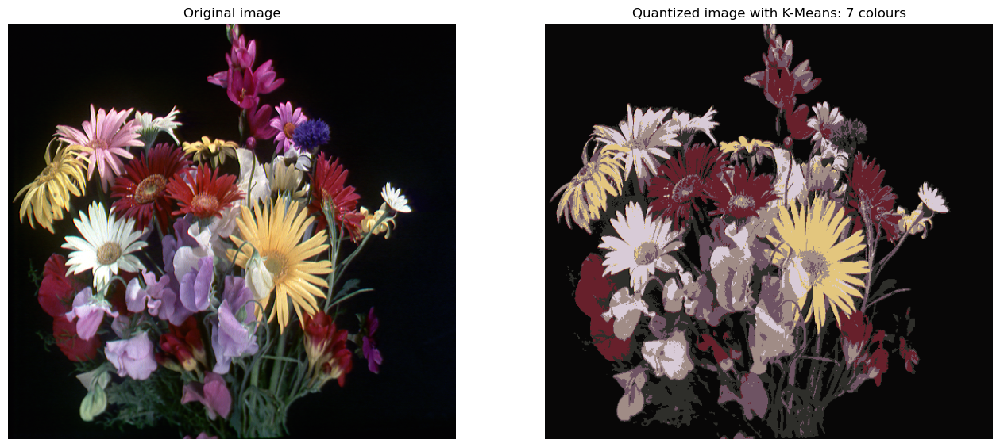

In [100]:
apply_kmeans3(ima,7)

avec un nombre de couleurs égale à 7 on peut avoir un rendu acceptable 

Proposez une solution pour retrouver les planches-mères utilisées pour l’impression d’une carte IGN : carte.tif :
Pour ce probleme on peut appliquer un filtre moyenneur pour attuner les differences brutale du niveau de gris. puis appliquer l'algorithme de k-means


Fitting model on a small sub-sample of the data
done in 0.061s.
Predicting color indices on the full image (k-means)
done in 0.001s.


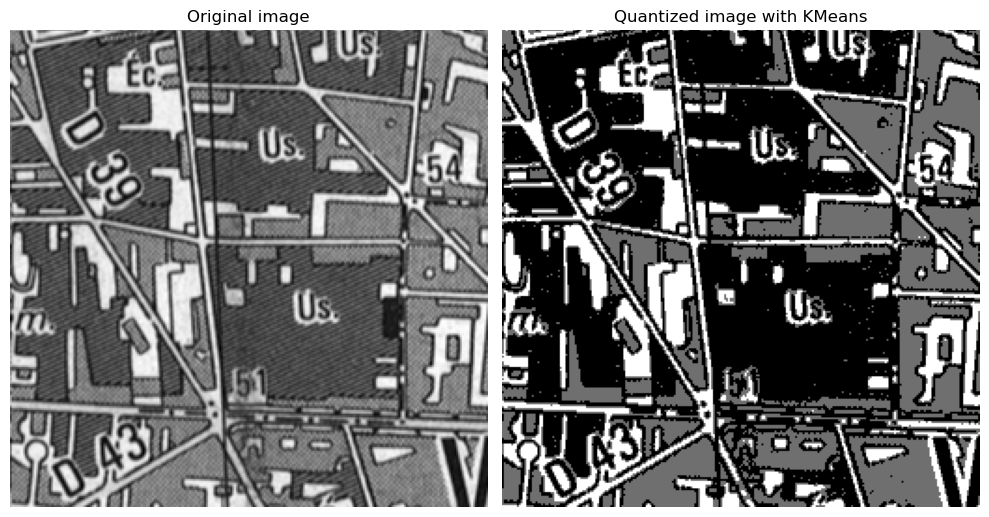

In [125]:
ima=io.imread("carte.tif")
filtred_ima=filtre_lineaire(ima,kernel)
apply_kmeans1(filtred_ima,3)

## 4 Seuillage automatique : Otsu

In [40]:
def histogram(im):
    
    nl,nc=im.shape
    
    hist=np.zeros(256)
    
    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1
            
    hist=hist/(nc*nl)
        
    return(hist)
    
    
def otsu_thresh(im):
    warnings.filterwarnings('ignore')
    h=histogram(im)
    
    m=0
    for i in range(256):
        m=m+i*h[i]
    
    maxt=0
    maxk=0
    
    
    for t in range(256):
        w0=0
        w1=0
        m0=0
        m1=0
        for i in range(t):
            w0=w0+h[i]
            m0=m0+i*h[i]
        if w0 > 0:
            m0=m0/w0
        
        for i in range(t,256):
            w1=w1+h[i]
            m1=m1+i*h[i]
        if w1 > 0:   
            m1=m1/w1
        
        k=w0*w1*(m0-m1)*(m0-m1)    
        
        if k > maxk:
            maxk=k
            maxt=t
            
            
    thresh=maxt
        
    return(thresh)


def compute_threshold (image):
    thresh = threshold_otsu(image) 
    binary = image > thresh

    fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
    ax = axes.ravel()
    ax[0] = plt.subplot(1, 3, 1)
    ax[1] = plt.subplot(1, 3, 2)
    ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

    ax[0].imshow(image, cmap=plt.cm.gray)
    ax[0].set_title('Original')
    ax[0].axis('off')

    bins=np.max(image)-np.min(image)+1

    ax[1].hist(image.ravel(), bins=bins)
    ax[1].set_title('Histogram')
    ax[1].axvline(thresh, color='r')
    ax[1].axis('off')
    
    ax[2].imshow(binary, cmap=plt.cm.gray)
    ax[2].set_title('Thresholded')
    ax[2].axis('off')

    plt.show()




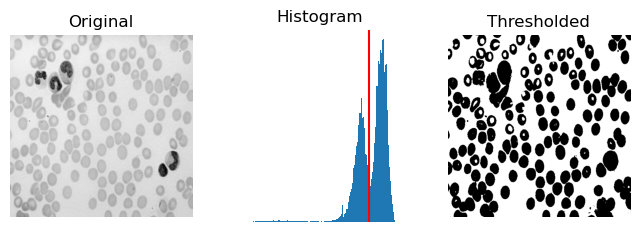

In [18]:
image =io.imread('cell.tif')
compute_threshold(image)

Nous cherchons à optimiser la meilleur valeur de seuil qui nous donne maximise la valeur de k : multiplication des
probabilités á priori, fois l'écart élevé au carré entre les moyennes des classes

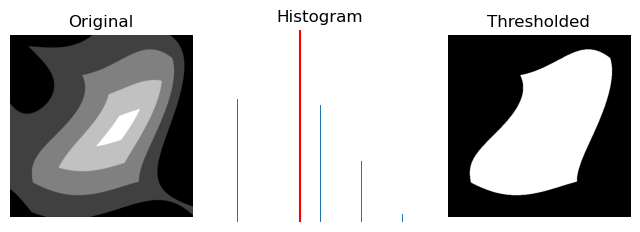

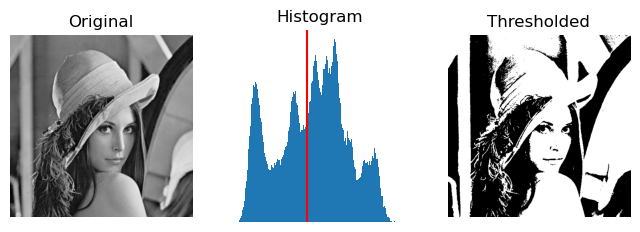

In [20]:
image1 =io.imread('pyramide.tif')
image2 =io.imread('lena.tif')
compute_threshold(image1)
compute_threshold(image2)

l'algorithme donne des bonnes resultat pour les image à deux classe (tels que l'image de cell )

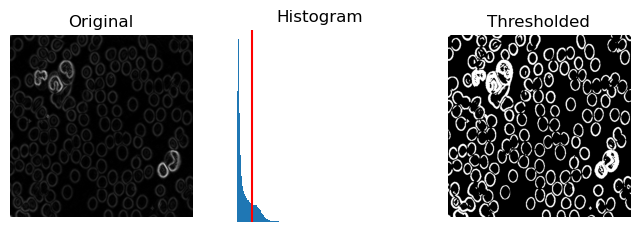

In [38]:
image3=io.imread("cell.tif")
gradx=dericheGradY(image3,0.7)
grady=dericheGradX(image3,0.7)
norme=np.sqrt(gradx*gradx+grady*grady)
compute_threshold((norme).astype(int))

oui, cet algorithme peut etre utilisé pour comme une alternative de seuillage pour la norme de gradient pour détecter le bon contour. En effet, Les normes plus grandes (plus claires), qui sont les contours devrait être sépare du noir (qu’est pas de contour).

In [10]:
def otsu_thresh2(im):
    warnings.filterwarnings('ignore')
    h=histogram(im)
    maxt=[0,0]
    maxk=0
    for t1 in range(256):
        for t2 in range(t1,256) :    
            w0=0
            w1=0
            w2=0
            m0=0
            m1=0
            m2=0
            for i in range(t1):
                w0=w0+h[i]
                m0=m0+i*h[i]
            if w0 > 0:
                m0=m0/w0
            for i in range(t1,t2):
                w1=w1+h[i]
                m1=m1+i*h[i]
            if w1 > 0:   
                m1=m1/w1
            for i in range(t2,256):
                w2=w2+h[i]
                m2=m2+i*h[i]
            if w1 > 0:   
                m2=m2/w2

            k=w0*w1*w2*(m0-m1)*(m0-m1)*(m2-m1)*(m2-m1)    

            if k > maxk:
                maxk=k
                maxt=[t1,t2]


        thresh=maxt

    return(thresh)
def compute_threshold2 (image):
    thresh = otsu_thresh2(image)
    result = np.zeros_like(image)
    result[ image > thresh[0]] = 128
    result[ image > thresh[1]] = 255
    
    #print(thresh,np.unique(result))
    fig, axes = plt.subplots(ncols=3, figsize=(8, 2.5))
    ax = axes.ravel()
    ax[0] = plt.subplot(1, 3, 1)
    ax[1] = plt.subplot(1, 3, 2)
    ax[2] = plt.subplot(1, 3, 3, sharex=ax[0], sharey=ax[0])

    ax[0].imshow(image, cmap=plt.cm.gray)
    ax[0].set_title('Original')
    ax[0].axis('off')

    bins=np.max(image)-np.min(image)+1

    ax[1].hist(image.ravel(), bins=bins)
    ax[1].set_title('Histogram')
    ax[1].axvline(thresh[0], color='r')
    ax[1].axvline(thresh[1], color='r')
    ax[1].axis('off')
    
    ax[2].imshow(result, cmap=plt.cm.gray)
    ax[2].set_title('Thresholded')
    ax[2].axis('off')

    plt.show()


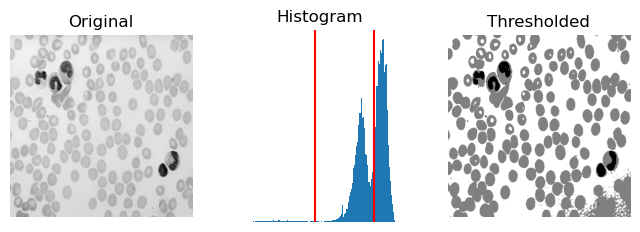

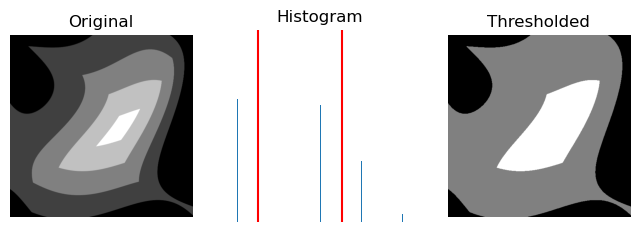

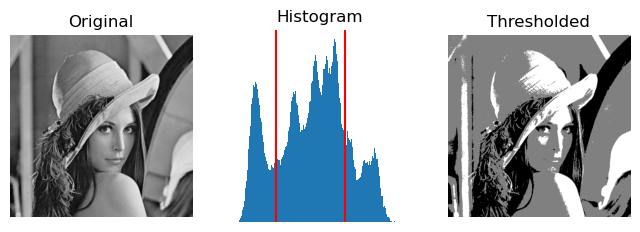

In [63]:
compute_threshold2(image)
compute_threshold2(image1)
compute_threshold2(image2)

## 5-Croissance de régions

In [ ]:
def my_perimeter(im):
    se=morpho.disk(1)
    dil=morpho.dilation(im,se)
    diff=dil-im
    ta=np.nonzero(diff)
    return ta
    
def histogram(im):
    
    nl,nc=im.shape
    
    hist=np.zeros(256)
    
    for i in range(nl):
        for j in range(nc):
            hist[im[i][j]]=hist[im[i][j]]+1
            
    for i in range(256):
        hist[i]=hist[i]/(nc*nl)
        
    return(hist)
 

im=io.imread('cerveau.tif')
mask=np.zeros((len(im),len(im[0])))

plt.figure('Image originale')
plt.imshow(im,cmap='gray')
plt.show()

### paramètres
# position du germe initial
y0=300
x0=300
# seuil du prédicat
thresh=2
# voisinage pour le calcul de la moyenne et de l'écart-type locaux
rayon=5

# Masque initial
mask[y0,x0]=255

ext=im[y0-rayon:y0+rayon+1,x0-rayon:x0+rayon+1]
m0=np.mean(ext)
s0=np.std(ext)

# Boucle tant qu'il y a des changements.

modif=1
iter = 0 
while modif >  0:

    iter=iter+1
        
    modif=0

    # Calcul du périmètre du masque
    
    per=my_perimeter(mask)

    # Boucle sur les points du périmètre
    for i in range (0 , len(per[0])):

        y=per[0][i]
        x=per[1][i]
        ext=im[y-rayon:y+rayon+1,x-rayon:x+rayon+1]
        m=np.mean(ext)
        s=np.std(ext)

        # Prédicat

        if np.abs(m0-m) < thresh * s0 :
            mask[y][x]=255
            modif=1

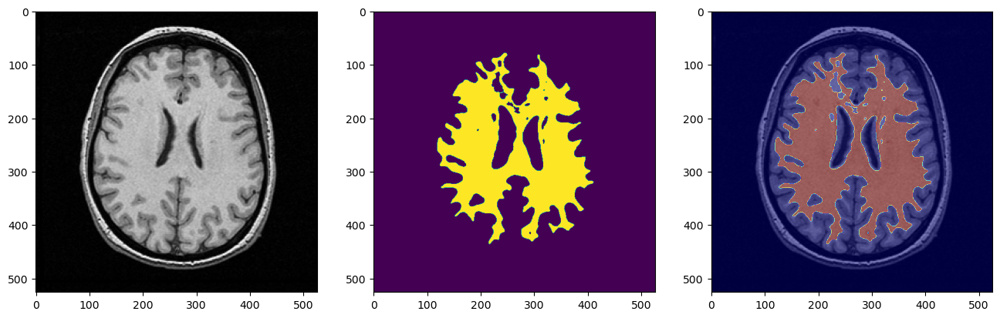

In [9]:
fig,axes = plt.subplots(1,3,figsize=(16,13))
axes[0].imshow(im,cmap='gray')
axes[2].imshow(im, cmap='gray')
axes[2].imshow(mask, cmap='jet', alpha=0.5)
axes[1].imshow(mask);

Pour etre ajouté à la region, le pixel dans le perimetre doit avoir une moyenne dans la fentre carré centré en ce pixel proche de la moyenne d'une meme fentre centre sur le pixel de départ avec une tolerance de thresh foirs l'ecart-type de la meme fentre de pixel original

Le parametre thresh influence sur notre hypothese de degres d'homogenieté. En effet, il presente le degre de regidité d'avoir une region semblalbe à celle de départ. Donc des fortes valeur de sueil vont engendrer plus de point accepté dans la region et inversement, pour des faible valeur de ce seuil on aura moin de pixel.

Les parametres sont le point de départ, le seuil et le rayon. En effet il est crucial d'avoir un point de départ dans un pixel de la matiere blanche pour que cette region soit reconnut avec cet algorithm. Le seuil et le rayon influence sur notre precision dans l'exploration des voisinage, des grosses valeurs pour ces deux parametre peut entrainer la couverture de la matiere grise avec la region de la matiere blanche meme si on a commencer avec un bon point de départ.

Non, il n'est pas possible de segementer toute la matiere grise avec cet algorithm. En effet, la zone qui contient la matiere grise n'est pas contigue. Elle se compose de plusieur région. avec un seul point de départ il n'est possible que d'obtenir l'un de ces région avec cet algorithm.

Le prédicat mis en oeuve est lié à la différences limitées des moyennes locaux. C'est le critere d'homogeniété d'une region donné dans cet algorithm

On peut retrouver le meme resultat on peut utiliser la méthode markovienne en considerant une énergie définie globalament  sur l'image et en la minimisant toute en respectant les contrainte d'attache aux données et de terme contextuel.

Le prédicat d'écart type (l'ecart type de la region ne depasse pas un certain seuil) nécessite reellement la méthode de croissance de région